# Import section

In [78]:
import pandas as pd
import numpy as np
from pprint import pprint
import requests
from bs4 import BeautifulSoup
import requests, re, json
import random
from tqdm import tqdm
from googlemaps import Client as GoogleMaps
import googlemaps
import gmaps
from keplergl import KeplerGl
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import geopy.distance
import pylab as pl
import plotly.express as px
import geopandas as gpd
from geopandas import GeoDataFrame
import json

# Intro

Now that I have collected the data of the real estate objects and the additional features, I'll perform the EDA part before moving on to modeling.

Each row of the real estate data set (df_zoopla) represents an object for rent in the area greater London. The columns represent different features of the objects like price, amount of bedrooms, bathrooms etc. 

The additional features include information from yelp. Most important is the location of the tube, train, gym and supermarkets as I will use these to create additional features. 

# Import of dataframes

In [79]:
df_zoopla = pd.read_csv("../1.zoopla/df_zoopla_final.csv", index_col = 0)
df_gym = pd.read_csv("../2.additionalfeatures/df_gym.csv", index_col = 0)
df_grocery = pd.read_csv("../2.additionalfeatures/df_grocery.csv", index_col = 0)
df_tube_train = pd.read_csv("../2.additionalfeatures/Londonstations.csv")

# Performing EDA on df_zoopla

## Reviewing general information

In [80]:
df_zoopla.shape

(83581, 14)

In [81]:
df_zoopla.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 83581 entries, 0 to 47916
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   name              83581 non-null  object 
 1   location          83581 non-null  object 
 2   price             83573 non-null  float64
 3   bedrooms          71161 non-null  float64
 4   bathrooms         77240 non-null  float64
 5   receptions        56284 non-null  float64
 6   published         83581 non-null  object 
 7   size              4467 non-null   float64
 8   public_transport  83479 non-null  object 
 9   describtion       83511 non-null  object 
 10  links             83581 non-null  object 
 11  latitude          83475 non-null  float64
 12  longitude         83475 non-null  float64
 13  postcode          83581 non-null  object 
dtypes: float64(7), object(7)
memory usage: 9.6+ MB


The data frame includes 14 columns with the following information: 
 -  name: Header of the description on zoopla
 -  location: description of the location
 -  price: price per month for the apartments/houses 
 -  bedrooms: amount of bedrooms
 -  bathrooms: amount of bathrooms
 -  receptions: amount of receptions
 -  published: Date when the object had been published on zoopla 
 -  size: if available the seize of the apartment 
 -  public_transport: list of close public transports
 -  description: description of the object
 -  links: direct link to the zoopla website with the object  
 -  longitude: longitude of the location
 -  latitude: latitude of the location
 -  postcode: postcode in which the object is located 

For my further EDA and modeling I will exclude some of the columns and only focus on numeric columns or columns which i will dummify at a later stage. 

In [82]:
df_zoopla = df_zoopla[['name', 'location', 'price', 'bedrooms', 'bathrooms', 'receptions', 
                      'published','postcode', 'longitude', 'latitude']]

In [83]:
df_zoopla.describe()

,price,bedrooms,bathrooms,receptions,longitude,latitude
count,83573.000000,71161.000000,77240.000000,56284.000000,83475.000000,83475.000000
mean,1886.720412,1.771209,1.253211,1.061065,-0.144244,51.508756
std,1663.168952,0.937463,0.558907,0.293886,0.121198,0.061612
min,35.000000,1.000000,1.000000,1.000000,-0.497496,51.288160
25%,1295.000000,1.000000,1.000000,1.000000,-0.212027,51.477073
50%,1600.000000,2.000000,1.000000,1.000000,-0.139682,51.511550
75%,2100.000000,2.000000,1.000000,1.000000,-0.065991,51.548702
max,108333.000000,9.000000,9.000000,8.000000,0.269372,51.713428


At a first look on the numeric values we can see that for the price we have extreme max and min. Later we will have a more detailed look on this. 

## missing values 

I will have a closer look for which columns if have missing values:

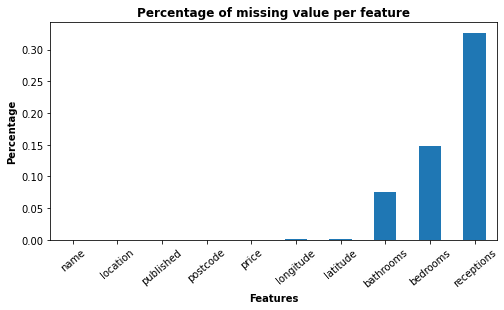

In [84]:
df_zoopla.isna().mean().sort_values().plot(
    kind="bar", figsize=(8,4))
plt.title("Percentage of missing value per feature", fontweight='bold')
plt.ylabel('Percentage', fontweight='bold')
plt.xticks(rotation=40)
plt.xlabel("Features", fontweight='bold')
plt.savefig('missing_values.png', dpi=300, bbox_inches = "tight")
plt.show()

In [85]:
df_zoopla.isna().sum()

name              0
location          0
price             8
bedrooms      12420
bathrooms      6341
receptions    27297
published         0
postcode          0
longitude       106
latitude        106
dtype: int64

Within the overview for zero values we can see that some columns include nan value. Especially for receptions more than 30% of the values. 

In the following section I will have a closer look at these missing values. 

### receptions

For the column reception I will just include a zero. Some of the apartments or houses simply have no receptions so i will assume for these no information had been provided on Zoopla. 

In [86]:
# unique values before adjustment
df_zoopla["receptions"].unique()

array([ 1., nan,  2.,  8.,  3.,  4.,  5.,  7.,  6.])

In [87]:
df_zoopla["receptions"] = df_zoopla["receptions"].fillna(0)

In [88]:
# unique values after adjustment 
df_zoopla["receptions"].unique()

array([1., 0., 2., 8., 3., 4., 5., 7., 6.])

### bedrooms

Also for the bedrooms we have some nan values. First I will have a look and some examples to decide how to treat these values: 

In [89]:
df_zoopla[df_zoopla["bedrooms"].isna()].head(10)

,name,location,price,bedrooms,bathrooms,receptions,published,postcode,longitude,latitude
1,Studio to rent,"Heathfield Road, Croydon CR0",900.0,NaN,1.0,1.0,2022-07-11,CR0,-0.097328,51.364870
3,Property to rent,"Parkland Road, London N22",795.0,NaN,1.0,0.0,2022-07-11,N22,-0.112083,51.595695
7,Studio to rent,"1-2 Riverbank Way, London TW8",1402.0,NaN,1.0,0.0,2022-07-11,TW8,-0.314863,51.487238
13,Studio to rent,"69 Lawrence Road, London N15",1475.0,NaN,1.0,0.0,2022-07-11,N15,-0.079821,51.586612
16,Studio to rent,"Lister Road, London E11",725.0,NaN,NaN,0.0,2022-07-11,E11,0.011282,51.564498
30,Studio to rent,"Battersea High Street, London SW11",1300.0,NaN,1.0,1.0,2022-07-11,SW11,-0.172848,51.470401
39,Studio to rent,"Gayton Road, Hampstead NW3",1500.0,NaN,1.0,1.0,2022-07-11,NW3,-0.174991,51.557151
43,Studio to rent,"Keats Way, London UB7",922.0,NaN,1.0,0.0,2022-07-11,UB7,-0.463538,51.497827
45,Room to rent,"Sherrick Green Road, Dollis Hill NW10",776.0,NaN,1.0,0.0,2022-07-11,NW10,-0.233155,51.552444
59,Studio to rent,"Gipsy Hill, London SE19",1100.0,NaN,1.0,0.0,2022-07-11,SE19,-0.083417,51.424490


After looking at the data I can see that a lot of these apartments are studios. For these kind of apartments I will include a zero to clearly separate the apartments with no separated bedroom. 

In [90]:
df_zoopla[df_zoopla["name"].str.contains("Studio")].head(5)

,name,location,price,bedrooms,bathrooms,receptions,published,postcode,longitude,latitude
1,Studio to rent,"Heathfield Road, Croydon CR0",900.0,NaN,1.0,1.0,2022-07-11,CR0,-0.097328,51.364870
7,Studio to rent,"1-2 Riverbank Way, London TW8",1402.0,NaN,1.0,0.0,2022-07-11,TW8,-0.314863,51.487238
13,Studio to rent,"69 Lawrence Road, London N15",1475.0,NaN,1.0,0.0,2022-07-11,N15,-0.079821,51.586612
16,Studio to rent,"Lister Road, London E11",725.0,NaN,NaN,0.0,2022-07-11,E11,0.011282,51.564498
24,Studio to rent,"117 Green Lanes, Newington Green N16",1200.0,1.0,1.0,0.0,2022-07-11,N16,-0.089386,51.554808


I will filter the data for objects which have an nan for the bedroom and the name includes "Studio". For all of these combinations I will include 0 for the bedrooms:

In [91]:
df_zoopla[df_zoopla["bedrooms"].isna() & df_zoopla["name"].str.contains("Studio")] = 0

Afterwards we still have some nan values for bedrooms, I will have again a look at some examples: 

In [92]:
df_zoopla[df_zoopla["bedrooms"].isna()]

,name,location,price,bedrooms,bathrooms,receptions,published,postcode,longitude,latitude
3,Property to rent,"Parkland Road, London N22",795.0,NaN,1.0,0.0,2022-07-11,N22,-0.112083,51.595695
45,Room to rent,"Sherrick Green Road, Dollis Hill NW10",776.0,NaN,1.0,0.0,2022-07-11,NW10,-0.233155,51.552444
81,Property to rent,"Kilburn High Road, London NW6",1200.0,NaN,1.0,1.0,2022-07-11,NW6,-0.199253,51.542665
85,Room to rent,"Clarendon Road, London E17",800.0,NaN,2.0,1.0,2022-07-11,E17,-0.013568,51.577218
248,Room to rent,"St Clement Close, Uxbridge UB8",650.0,NaN,2.0,1.0,2022-07-11,UB8,-0.477567,51.519960
...,...,...,...,...,...,...,...,...,...,...
47163,Room to rent,"Brondesbury Road, Queens Park, Kilburn, London...",780.0,NaN,1.0,1.0,2022-05-23,NW6,-0.202392,51.535370
47193,Room to rent,"Rogers Road, Tooting, London SW17",800.0,NaN,1.0,1.0,2022-05-23,SW17,-0.173843,51.432048
47196,Room to rent,"Herne Hill, London SE24",700.0,NaN,NaN,0.0,2022-05-23,SE24,-0.096661,51.454546
47711,Room to rent,"Callcott Road, Kilburn NW6",600.0,NaN,1.0,0.0,2022-05-21,NW6,-0.202300,51.541768


After reviewing the data it seems that some parking and single rooms for renting are included. Also some properties are included with zero bedrooms. For last onces I am not sure if this a mistake from the person which has published the object. To avoid misinterpretation i will drop the single rooms, garages and properties with 0 bedrooms.  

In [93]:
df_zoopla = df_zoopla[~df_zoopla["bedrooms"].isna()]

In [94]:
df_zoopla["bedrooms"].unique()

array([1., 0., 2., 5., 3., 6., 4., 8., 7., 9.])

The check for unique values shows that no nan is included anymore. 

### bathrooms

In [95]:
df_zoopla[df_zoopla["bathrooms"].isna()]

,name,location,price,bedrooms,bathrooms,receptions,published,postcode,longitude,latitude
4,1 bed flat to rent,"Briant Street, London SE14",1395.0,1.0,NaN,1.0,2022-07-11,SE14,-0.049942,51.475295
82,1 bed flat to rent,"Roundhedge Way, Enfield EN2",1100.0,1.0,NaN,1.0,2022-07-11,EN2,-0.108580,51.667120
91,Studio to rent,"Courtfield Gardens, Earls Court, London SW5",1200.0,1.0,NaN,0.0,2022-07-11,SW5,-0.189540,51.493288
172,2 bed property to rent,"Eland Road, Croydon CR0",1500.0,2.0,NaN,0.0,2022-07-11,CR0,-0.109772,51.371420
264,Room to rent,"Rainbow Avenue, London E14",950.0,1.0,NaN,1.0,2022-07-11,E14,-0.019035,51.487590
...,...,...,...,...,...,...,...,...,...,...
47855,3 bed flat to rent,"Collingham Place, Earls Court, London SW5",3684.0,3.0,NaN,0.0,2022-05-20,SW5,-0.189391,51.494014
47872,1 bed flat to rent,"John Harrison Way, London SE10",1500.0,1.0,NaN,0.0,2022-05-20,SE10,0.012131,51.494891
47875,2 bed flat to rent,"Minster Road, Kilburn, London NW2",1777.0,2.0,NaN,0.0,2022-05-20,NW2,-0.205749,51.552586
47876,1 bed flat to rent,"Kings Road, Willesden Green, London NW10",1603.0,1.0,NaN,0.0,2022-05-20,NW10,-0.232757,51.545273


Surprisingly some the object are also showing that no bathroom is included. I looked at some examples and can't identify any pattern here. My First impression was that these could also be shared rooms. But within the results also bigger flats with 1, 2 or 3 rooms had been included. To not mess up my results i will exclude the results which are showing nan for bathrooms. I will lose some scrapped objects but it will still be enough to move on with the modeling. 

In [96]:
df_zoopla = df_zoopla[~df_zoopla["bathrooms"].isna()]

### location_long location_lat

For some of the rows it seems that the google api was not able to identify the longitude and latitude. I will exclude these objects from the data. 

In [97]:
df_zoopla = df_zoopla[~df_zoopla["longitude"].isna()]

### price

The price column also included some nan. I will drop these objects directly as the price will be my target variable within the modeling. 

In [98]:
df_zoopla = df_zoopla[~df_zoopla["price"].isna()]

In [99]:
df_zoopla.isna().sum()

name          0
location      0
price         0
bedrooms      0
bathrooms     0
receptions    0
published     0
postcode      0
longitude     0
latitude      0
dtype: int64

The final checks shows no NAN are included anymore. 

## Outliers

Within a next step I will have a look if the values for the different columns makes sense or if we have essential outliers which would require some cleaning and filtering of the data. 

In [100]:
df_zoopla.describe()

,price,bedrooms,bathrooms,receptions,longitude,latitude
count,77639.000000,77639.000000,77639.000000,77639.000000,77639.000000,77639.000000
mean,1723.049408,1.519121,1.105566,0.683535,-0.122506,44.045118
std,1797.503053,1.068576,0.711590,0.555487,0.125338,18.129499
min,0.000000,0.000000,0.000000,0.000000,-0.497496,0.000000
25%,1150.000000,1.000000,1.000000,0.000000,-0.200638,51.428294
50%,1600.000000,1.000000,1.000000,1.000000,-0.113463,51.499047
75%,2100.000000,2.000000,1.000000,1.000000,-0.006872,51.539276
max,108333.000000,9.000000,9.000000,8.000000,0.268135,51.713428


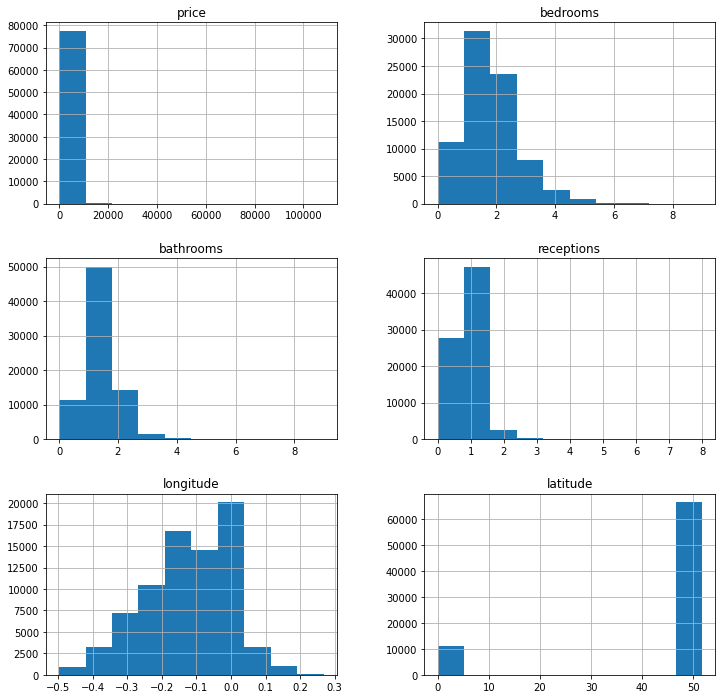

In [101]:
df_zoopla.hist(figsize=(12, 12))
plt.show()

Looking at the histograms for the data we can see that the price sections has some high outliers. Furthermore for the location_lat section it seems like that there is an outliers included which is not directly in London. I will have a closer look at these values with some Boxplots:

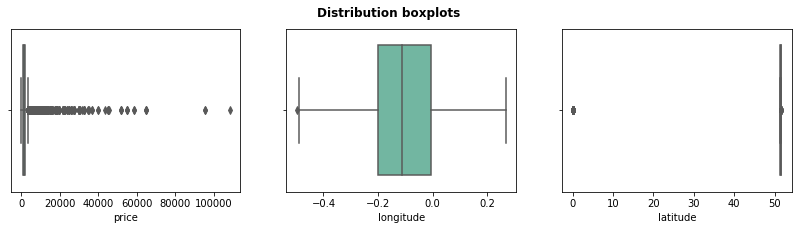

In [102]:
fig, ax = plt.subplots(ncols=3, figsize=(14,3))
fig.suptitle("Distribution boxplots", fontweight='bold')
sns.boxplot(x=df_zoopla.price, ax=ax[0], palette="Set2")
sns.boxplot(x= df_zoopla.longitude, ax=ax[1], palette="Set2")
sns.boxplot(x= df_zoopla.latitude, ax=ax[2], palette="Set2")
plt.savefig('boxplots.png', dpi=300, bbox_inches = "tight")
plt.show()

### Price

As seen above the price column has definitely some outliers. In the above boxplot we can see that the price is very skewed. For this reason it will make more sense to use the median instead of the mean to reduce the results. This is because the large values on the tail end of the distribution tend to pull the mean away from the center and towards the long tail.

I decided to calculate a range of 3 around the median of the price and use this as borders for outliers. 

In [103]:
top_price = df_zoopla["price"].median() + 3 * df_zoopla["price"].std()
bottom_price = df_zoopla["price"].median() - 3 * df_zoopla["price"].std()

In [104]:
print("Median:" , df_zoopla["price"].median())
print("Top price:" , top_price)
print("Bottom Price:" , bottom_price)

Median: 1600.0
Top price: 6992.509157598993
Bottom Price: -3792.5091575989927


In [105]:
df_zoopla = df_zoopla[(df_zoopla["price"] < top_price) & (df_zoopla["price"] > bottom_price)]

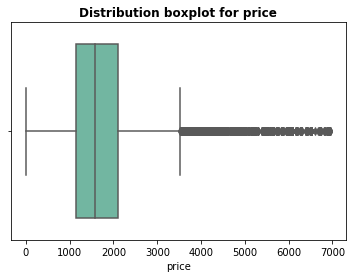

In [106]:
sns.boxplot(x=df_zoopla.price, palette="Set2")
plt.title("Distribution boxplot for price", fontweight='bold')
plt.show()

The updated boxplot still shows some outliers but after the filtering based on the median this should be enough to move on. 

### longitude and latitude

One of the values for the latitude is definitely is valued 0, combined with the longitude this is outside of London. I will exclude all object with a latitude below 40.

In [107]:
fig = px.scatter_mapbox(df_zoopla, lat="latitude", lon="longitude",
                       center=dict(lat=51.50722, lon=-0.1275), zoom=0,
                       mapbox_style="open-street-map",
                       width=800, height=600)
fig.show()

In [108]:
df_zoopla = df_zoopla[df_zoopla["latitude"] > 40]

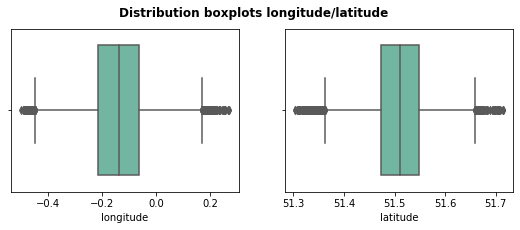

In [109]:
fig, ax = plt.subplots(ncols=2, figsize=(9,3))
fig.suptitle("Distribution boxplots longitude/latitude", fontweight='bold')
sns.boxplot(x= df_zoopla.longitude, ax=ax[0], palette="Set2")
sns.boxplot(x= df_zoopla.latitude, ax=ax[1], palette="Set2")
plt.show()

Looking at the longitude and latitude it seems that there are still some outliers, but we would need to see this on a map to identify if these object are outside of London

In [110]:
fig = px.scatter_mapbox(df_zoopla, lat="latitude", lon="longitude",
                       center=dict(lat=51.50722, lon=-0.1275), zoom=8.8,
                       mapbox_style="open-street-map",
                       width=800, height=600)
fig.show()

Looking at the map all of the objects are located in London. 

## Further Visualisation 

### Pairplot

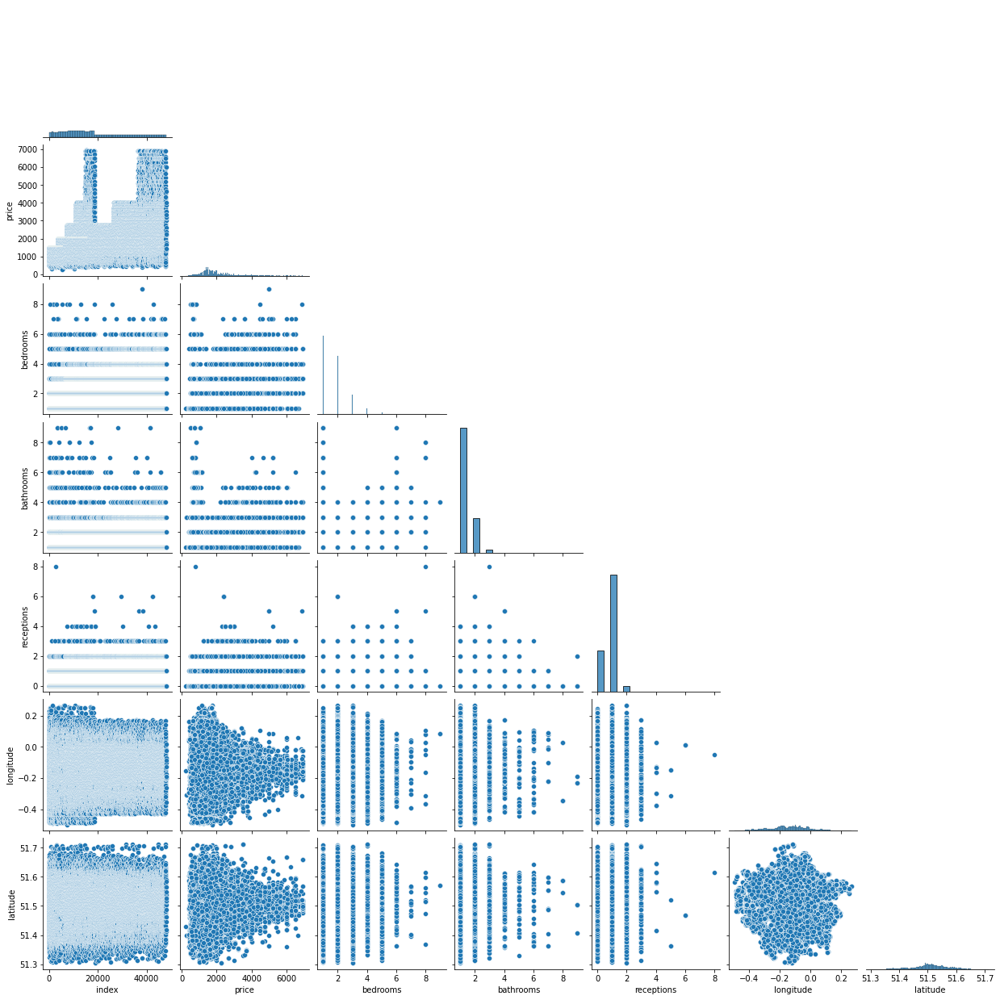

In [111]:
sns.pairplot(df_zoopla.reset_index(), corner = True, palette="Set2")
plt.show()

Looking at the pairplot we can see that the higher prices of apartments are within the center of latitude and longitude. As expected the prices in the middle of London are higher than outside.

### Correlations

I would like to have a first look at the correlation of the numeric data:

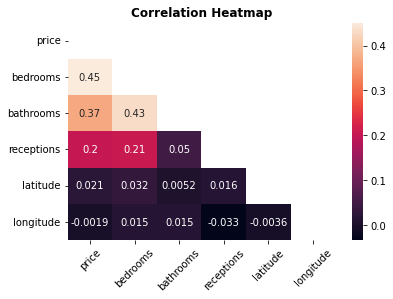

In [112]:
correlation_matrix = df_zoopla[['price', 'bedrooms', 'bathrooms', 'receptions', 
                       'latitude', 'longitude']].corr()
matrix = np.triu(correlation_matrix)

heat_map = sns.heatmap(correlation_matrix, annot=True, mask=matrix )
plt.title("Correlation Heatmap", fontweight='bold')
heat_map.set_xticklabels(heat_map.get_xticklabels(), rotation=45)
plt.savefig('heatmap.png', dpi=300, bbox_inches = "tight")
plt.show()

Surprisingly the longitude and latitude show no big impact on the price. From a first view this could lead to the impression that the location is not important. But from the pairplot above we can see that the high prices are more in the middle of London. I will keep this in mind and further investigate on this. 

### Grouping Data sections

#### Price per postcode

As the longitude and latitude showed no big impact i would like to see how the postcodes are having an impact on the price. First i will have a look at the median price per postcode to identify if there areas which seem to have a higher median price. 

In [113]:
df_postcode_price = df_zoopla[['price',"postcode"]] \
        .groupby('postcode', as_index = True) \
        .agg(median_price=('price', 'median'), count_objects=('price', 'size')) \
        .sort_values("median_price", ascending=False)
df_postcode_price[df_postcode_price["count_objects"] > 50]

,median_price,count_objects
postcode,,
SW3,3467.0,533
SW7,2990.0,325
W1,2817.0,859
EC2,2808.5,156
WC2,2708.0,169
...,...,...
TW13,1165.0,201
UB5,1150.0,203
CR7,1149.0,235


Looks like we have the highest prices in SW13. so the location definitely has an impact. I want to see where these postcodes are located within London: 

In [114]:
from IPython.display import Image
Image(url= "london-map-postcodes.jpg", width=600, height=600)

Looking at the postcode map for London we can see that the postcodes with the highest mean are located within the center. Also a heatmap is giving us the same result: 

In [115]:
fig = px.density_mapbox(df_zoopla, lat="latitude", lon="longitude", z="price",radius=4,
                       center=dict(lat=51.50722, lon=-0.1275), zoom=8.8,
                       mapbox_style="open-street-map",
                       title= "Price Heat Map",
                       width=800, height=600)
fig.show()

I will create a price category column for price ranges to visually see where are the higher prices located. 

In [116]:
df_plotly = df_zoopla[["name", "bedrooms", "bathrooms", "receptions", "price", "longitude", "latitude"]]

def price_categories(x):
    if x <= 1000:
        return 1
    elif x <= 2000:
        return 2 
    elif x <= 3000:
        return 3
    elif x <= 4000:
        return 4
    elif x <= 5000:
        return 5
    else:
        return 6
    
df_plotly['price_categorie'] = df_plotly["price"].apply(price_categories)    

/var/folders/3p/8d6w00bn0vngwxs3g0sktgmc0000gn/T/ipykernel_988/1294818678.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [117]:
fig = px.scatter_mapbox(df_plotly,
              lat="latitude" ,
              lon="longitude",
              hover_name="name",
              animation_frame='price_categorie',
              mapbox_style='carto-positron',                
              zoom=8,
              title="Overview pricecategories")
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 7000         
fig.show();

I created the following price categories:
- 1: rent <= 1000:
- 2: 1000 < rent <= 2000
- 3: 2000 < rent <= 3000
- 4: 3000 < rent <= 4000
- 5: 4000 < rent <= 5000
- 6: 6000 < rent

Within the above scatterplot we can change the different categories and see that the objects with higher prices are more appearing within the center of London. 

#### Bedrooms and mean price

The amount of bedrooms showed the biggest correlation on the correlation matrix above. 

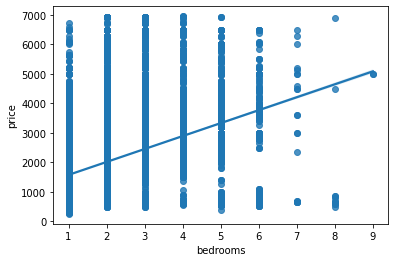

In [118]:
sns.regplot(x='bedrooms',y='price',data=df_zoopla)
plt.show()

We can see definitely that with a higher amounts of bedrooms the price increases but also we can see that the highest price is an object with 3 bedrooms. So other factors are also important. 

In [119]:
df_bedroom_price = df_zoopla[['price',"bedrooms"]] \
        .groupby('bedrooms', as_index = True) \
        .agg(median_price=('price', 'median'), count_objects=('price', 'size')) \
        .sort_values("median_price", ascending=False)
df_bedroom_price[df_bedroom_price["count_objects"] > 50]

,median_price,count_objects
bedrooms,,
6.0,3600.0,150
5.0,3000.0,715
4.0,2700.0,2379
3.0,2195.0,7714
2.0,1842.0,23460
1.0,1400.0,31323


I filtered the results based on the bedrooms and sorted them by mean price. I only want to look at amount of bedrooms when there are more than 50 results so that the result is representative. I can see that most objects only have one bedroom and that the more bedrooms we have the higher the median price will be.

# additional features 

I scraped some additional information which i would like to include into the final dataset as additional features. I scraped the location of gyms, supermarkets and public transport stations. Within a next step i will calculate the distance between the object and the additional features and include the following: 

1. Amount of grocery stores within a 1km range
2. amount of train/tube stations within a 1km range
3. amount of gyms within a 1km range
4. check which stations are within this 1km range
5. check which supermarkets are within this 1km range


## cleaning the additional data

Before calculating the above values I will check if the gyms, supermarkets and tube/train stations are only within London.

In [120]:
# Create a gepdataframe
map2 = KeplerGl(height=600, width=800)#show the map

# Add data to Kepler
gdf1 = gpd.GeoDataFrame(df_grocery, geometry=gpd.points_from_xy(df_grocery.grocery_long, df_grocery.grocery_lat))
gdf2 = gpd.GeoDataFrame(df_tube_train, geometry=gpd.points_from_xy(df_tube_train.Longitude, df_tube_train.Latitude))
gdf3 = gpd.GeoDataFrame(df_gym, geometry=gpd.points_from_xy(df_gym.gym_long, df_gym.gym_lat))

# adding geo enabled dataframe to map
map2.add_data(data=gdf1, name='Grocery')
map2.add_data(data=gdf2, name='tube_train')
map2.add_data(data=gdf3, name='gym')
map2

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'Grocery': {'index': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,…

We can see that a some of scraped locations are actually not within London. especially for the grocery stores it is surprisingly that also stores in America had been included. I would like to conclude the outer ring of London as border for results. I will use the same boarders that have been used for the real estate objects: 
- longitude should be between 51.264825 and 51.6877167
- latitude should be between -0.498934 and 0.271996

In [121]:
max_lat = 51.6877167
min_lat = 51.264825

max_long = 0.271996
min_long = -0.498934

Afterwards I will filter the dataframes and exclude the locations outside mt restrictions: 

In [122]:
df_grocery= df_grocery.drop(df_grocery[(df_grocery["grocery_long"]> max_long) | (df_grocery["grocery_long"]< min_long)].index)
df_grocery= df_grocery.drop(df_grocery[(df_grocery["grocery_lat"]> max_lat) | (df_grocery["grocery_lat"]< min_lat)].index)

df_tube_train= df_tube_train.drop(df_tube_train[(df_tube_train["Longitude"]> max_long) | (df_tube_train["Longitude"]< min_long)].index)
df_tube_train= df_tube_train.drop(df_tube_train[(df_tube_train["Latitude"]> max_lat) | (df_tube_train["Latitude"]< min_lat)].index)

In [123]:
map3 = KeplerGl(height=600, width=800)#show the map

# Add data to Kepler
gdf1 = gpd.GeoDataFrame(df_grocery, geometry=gpd.points_from_xy(df_grocery.grocery_long, df_grocery.grocery_lat))
gdf2 = gpd.GeoDataFrame(df_tube_train, geometry=gpd.points_from_xy(df_tube_train.Longitude, df_tube_train.Latitude))
gdf3 = gpd.GeoDataFrame(df_gym, geometry=gpd.points_from_xy(df_gym.gym_long, df_gym.gym_lat))

# adding geo enabled dataframe to map
map3.add_data(data=gdf1, name='Grocery')
map3.add_data(data=gdf2, name='tube_train')
map3.add_data(data=gdf3, name='gym')
map3

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'Grocery': {'index': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,…

Now all of the data is within London.

Within the next step i will count the grocery stores, gyms and public transport stations which are within a range of 1 km to the object

## Calculatin distance to objects

The below code will iterate through the zoopla datasets and all objects include. For each object it will calculate the distance the the gyms, supermarkets, train stations and tube stations. Whenever one of them is maximum 1km away it will update this information in the dataframe for the additional features. 

In [124]:
df_additional_features = pd.DataFrame(columns=['longitude', 'latitude', 
                             "nr_pb_trans","nr_gym", "tesco", "marks_and_Spencer","sainsbury","whole_foods"])

for row in tqdm(range(0,len(df_zoopla))):
    long_1 = df_zoopla.iloc[row]['longitude']
    lat_1 = df_zoopla.iloc[row]['latitude']
    
    count_gym = 0       
    for i in range (0, len(df_gym)):
            long_2 = df_gym.iloc[i]['gym_long']
            lat_2 = df_gym.iloc[i]['gym_lat']
            
            #distance = haversine_vectorize(long_1, lat_1, long_2, lat_2)
            distance = geopy.distance.distance((long_1, lat_1),(long_2, lat_2)).km
            
            if distance <= 1:
                count_gym += 1
            else:
                pass       
            
    tesco_count = 0
    marks_count = 0
    sains_count = 0
    whole_count = 0
    for i in range (0, len(df_grocery)):
            name = df_grocery.iloc[i]['name']
            long_2 = df_grocery.iloc[i]['grocery_long']
            lat_2 = df_grocery.iloc[i]['grocery_lat']
            
            #distance = haversine_vectorize(long_1, lat_1, long_2, lat_2)
            distance = geopy.distance.distance((long_1, lat_1),(long_2, lat_2)).km
            
            if distance <= 1 and name == "Tesco":
                tesco_count += 1
            elif distance <= 1 and name == "Sainsbury":
                sains_count += 1
            elif distance <= 1 and name == "Marks and Spencer":
                marks_count += 1    
            elif distance <= 1 and name == "Whole Foods":
                whole_count += 1
            else:
                pass    
                    
    df_additional_features = df_additional_features.append(
                             {'longitude':long_1,
                              'latitude':lat_1,
                              "nr_gym":count_gym,
                              "tesco":tesco_count, 
                              "marks_and_Spencer": marks_count,
                              "sainsbury": sains_count,
                              "whole_foods": whole_count},
                              ignore_index=True)   
    
    count_public_transport = 0
    for i in range(0, len(df_tube_train)):
            long_2 = df_tube_train.iloc[i]['Longitude']
            lat_2 = df_tube_train.iloc[i]['Latitude']
            station = df_tube_train.iloc[i]['Station']
            
            #distance = haversine_vectorize(long_1, lat_1, long_2, lat_2)
            distance = geopy.distance.distance((long_1, lat_2),(long_2, lat_2)).km
            
            if distance <= 1:
                count_public_transport += 1
                df_additional_features.loc[row, station] = 1
            else:
                df_additional_features.loc[row, station] = 0
                
    df_additional_features.loc[row, "nr_pb_trans"] = count_public_transport

  0%|                                                 | 0/65777 [00:00<?, ?it/s]/Users/johannesebert/opt/anaconda3/lib/python3.9/site-packages/pandas/core/indexing.py:1684: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`

100%|██████████████████████████████████| 65777/65777 [22:12:25<00:00,  1.22s/it]


Now that I have gathered the close by locations I will combine the result with the main Zoopla dataframe 

In [126]:
print(df_zoopla.shape)
print(df_additional_features.shape)

(65777, 10)
(65777, 641)


In [128]:
# before merging the dataset we need to reset the index of df_zoopla and drop the longotude and latitude from the additional features set 
df_zoopla = df_zoopla.reset_index()
df_additional_features.drop(columns=["longitude", "latitude"], inplace=True)

Afterwards I will combine both datasets:

In [129]:
df_data = pd.concat([df_zoopla, df_additional_features], axis = 1)

In [132]:
df_data.drop(["index"], axis=1, inplace=True)

In [ ]:
#load data
#df_data = pd.read_csv("df_data.csv", index_col = 0)

In [136]:
df_data.shape

(65777, 649)

# EDA on complete Dataset

As a first impression I would like to check the correlation on the full dataset. At the moment the dataFrame includes 649 columns. As the correlation matrix would be to big I just would like to check on the highest correlation together with the price and check if the additional features will be included.

In [137]:
correlation_matrix_2 = df_data.corr()

In [138]:
df_corr = pd.DataFrame(correlation_matrix_2["price"])
df_corr.columns =["Corr"]
df_corr['Abs_corr'] = abs(df_corr["Corr"])
df_corr.drop("price", inplace= True)

In [139]:
df_corr.sort_values("Abs_corr", ascending = False).head(11)

,Corr,Abs_corr
bedrooms,0.451134,0.451134
bathrooms,0.366356,0.366356
tesco,0.307859,0.307859
nr_gym,0.287627,0.287627
marks_and_Spencer,0.238703,0.238703
sainsbury,0.231870,0.231870
nr_pb_trans,0.213934,0.213934
receptions,0.202759,0.202759
Oakleigh Park,0.194228,0.194228
Edgware Road (Circle/District/Hammersmith and City),0.194068,0.194068


Tesco, nr_gym, sainsbury and marks_and_Spencer are not showing a correlation. Within a next step I will investigate the impact of different features within the modeling.  

# Saving the final data for the next step modeling 

In [141]:
df_data.to_csv(f'df_data.csv')

In [142]:
df_data.shape

(65777, 649)